<a href="https://colab.research.google.com/github/jayu071/Seoul-Bike-Sharing-Demand_JN/blob/main/JN_Bike_Sharing_Demand_Prediction_Capstone_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <b><u> Project Title : Seoul Bike Sharing Demand Prediction </u></b>

## <b> Problem Description </b>

 Currently Rental bikes are introduced in many urban cities for the enhancement of mobility comfort. It is important to make the rental bike available and accessible to the public at the right time as it lessens the waiting time. Eventually, providing the city with a stable supply of rental bikes becomes a major concern. The crucial part is the prediction of bike count required at each hour for the stable supply of rental bikes.

Our objective is to find a way to estimate the value prediction of bike count required at each hour for the stable supply of rental bikes. using the values in the other columns. If we can do so for the historical data, then we should able to estimate bike count required at each hour.

# *Supervised ML- Regression model using Seoul Bike Sharing Demand Prediction Data Set*

## <b> Data Description </b>

The dataset contains weather information (Temperature, Humidity, Windspeed, Visibility, Dewpoint, Solar radiation, Snowfall, Rainfall), the number of bikes rented per hour and date information.


### <b>Attribute Information: </b>

*  Date : year-month-day
*  Rented Bike count - Count of bikes rented at each hour
*  Hour - Hour of he day
*  Temperature-Temperature in Celsius
*  Humidity - %
*  Windspeed - m/s
*  Visibility - 10m
*  Dew point temperature - Celsius
*  Solar radiation - MJ/m2
*  Rainfall - mm
*  Snowfall - cm
*  Seasons - Winter, Spring, Summer, Autumn
*  Holiday - Holiday/No holiday
*  Functional Day - NoFunc(Non Functional Hours), Fun(Functional hours)

-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.-.


> All the Lifecycle In A Data Science Projects
1. Loading data and Diagnosing the data
2. Data Filtering 
3. EDA of Row data to understand inside correlations
4. Feature Engineering
5. Feature Selection : we are not use much beacuase of limited features in our data(only one feature elemenate using hitmap to escalate multicoliniarity issue)
6. Model Building
7. Model Training and Testing
8. Model Evalution & Hyper Perameter tuning
9. Model Deployment

----

## **1. Import Libraries and Data**


In [1]:
# Import necessary libraries

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV, cross_val_score
from sklearn import preprocessing, linear_model
from sklearn.preprocessing import  LabelEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler 
from sklearn.metrics import r2_score, mean_squared_error, accuracy_score
from sklearn.linear_model import Ridge, Lasso, LinearRegression, LogisticRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, GradientBoostingRegressor
from sklearn import neighbors
from sklearn.svm import SVR


import xgboost as xgb
from xgboost import plot_importance

from lightgbm import LGBMRegressor

import warnings
warnings.filterwarnings('ignore')

pd.pandas.set_option('display.max_columns',None)
%matplotlib inline

###*1.1 _ Data Loading*

We can now create a Pandas dataframe using the downloaded file, to view and analyze the data.

In [2]:
# Mount Drive to load data.
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# Read the csv file
data=pd.read_csv("/content/drive/MyDrive/Almabetter /CapstoneProject/Bike Sharing Demand Predication/SeoulBikeData.csv",encoding= 'unicode_escape')

#####1.1.1 _ First Look Data and Identify Features

In [4]:
%load_ext google.colab.data_table
data

,Date,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(°C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day
0,01/12/2017,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
1,01/12/2017,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
2,01/12/2017,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,Yes
3,01/12/2017,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
4,01/12/2017,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,30/11/2018,1003,19,4.2,34,2.6,1894,-10.3,0.0,0.0,0.0,Autumn,No Holiday,Yes
8756,30/11/2018,764,20,3.4,37,2.3,2000,-9.9,0.0,0.0,0.0,Autumn,No Holiday,Yes
8757,30/11/2018,694,21,2.6,39,0.3,1968,-9.9,0.0,0.0,0.0,Autumn,No Holiday,Yes
8758,30/11/2018,712,22,2.1,41,1.0,1859,-9.8,0.0,0.0,0.0,Autumn,No Holiday,Yes


The dataset contains 8760 rows and 14 columns. Each row of the dataset contains information about weather conditions

|Column| Data details inside column |
|------|----------------------------|
|Date| Date of Rented Bike | 
|Rented Bike count | Number of total rentals|
|Hour | Hours of the day |
|Temperature(°C)| Weather Temperature in °C |
|Humidity(%)| Humidity of the day in %|
|	Wind speed (m/s)| Wind speed in m/s |
|Visibility (10m)| Atmospherical Visibility within 10 𝑚 range |
|Dew point temperature(°C) | Dew Point Temperature - T dp in °C |
|Solar Radiation (MJ/m2) | Indicate light and energy that comes from the sun in MJ/m2 | 
|Rainfall(mm)	| Rain fall in mm |
|Snowfall (cm) | Snow fall in cm |
|Seasons| Autumn, Spring, Summer, Winter |
|Holiday|Whether the day is considered a holiday|	
|Functioning Day|Whether the day is neither a weekend nor holiday|



Our objective is to find a way to estimate the value prediction of bike count required at each hour for the stable supply of rental bikes. using the values in the other columns. If we can do so for the historical data, then we should able to estimate bike count required at each hour.

#### 1.1.2 _First Checking the duplicate entries in data

*   Duplicate entries given wrong pridiction and also consume unnecessory storage and consuming time during testing and training data

In [5]:
# Check for duplicated entries.
print("Duplicate entry in data:",len(data[data.duplicated()])) 

Duplicate entry in data: 0


Not found any duplicated entries inside the data

### *1.2 _ Diagnosing the Data*



In [6]:
# Custom Function for Dtype,Unique values and Null values
def datainfo():
    temp_ps = pd.DataFrame(index=data.columns)
    temp_ps['DataType'] = data.dtypes
    temp_ps["Non-null_Values"] = data.count()
    temp_ps['Unique_Values'] = data.nunique()
    temp_ps['NaN_Values'] = data.isnull().sum()
    temp_ps['NaN_Values_Percentage'] = (temp_ps['NaN_Values']/len(data))*100 
    return temp_ps

In [7]:
# Shape of the data.
print("Total Rows and Columns in DataFrame is :",data.shape,"\n") 
# Custom Function
datainfo()

Total Rows and Columns in DataFrame is : (8760, 14) 



,DataType,Non-null_Values,Unique_Values,NaN_Values,NaN_Values_Percentage
Date,object,8760,365,0,0.0
Rented Bike Count,int64,8760,2166,0,0.0
Hour,int64,8760,24,0,0.0
Temperature(°C),float64,8760,546,0,0.0
Humidity(%),int64,8760,90,0,0.0
Wind speed (m/s),float64,8760,65,0,0.0
Visibility (10m),int64,8760,1789,0,0.0
Dew point temperature(°C),float64,8760,556,0,0.0
Solar Radiation (MJ/m2),float64,8760,345,0,0.0
Rainfall(mm),float64,8760,61,0,0.0


Finding details from data:

1. There are 14 features with 8760 rows of data.
2. There are 4 categorical columns and 10 numerical columns. Columns ‘Date’, ‘Seasons’ and ‘Functioning Day’ are of 𝑜𝑏𝑗𝑒𝑐𝑡 data type
3. Columns ‘Rented Bike Count’, ‘Hour’, ‘Humidity (%)' and ‘Visibility (10𝑚)' are of 𝑖𝑛𝑡64 numarical data type
4. Columns ‘Temperature Temperature (℃)’, ‘Wind Speed (𝑚/𝑠)’, ‘Dew Point Temperature (℃)’,‘Solar Radiation (𝑀𝐽/𝑚2)’,‘Rainfall (𝑚𝑚)' and ‘Snowfall(𝑐𝑚) are of 𝑓𝑙𝑜𝑎𝑡64 numarical data type
5. Not any null value present in any column
6. Unique count : Seasons- 4 , Holiday- 2 , Functioning Day- 2

In [8]:
# Statistical info.
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Rented Bike Count,8760.0,704.602055,644.997468,0.0,191.00,504.50,1065.25,3556.00
Hour,8760.0,11.500000,6.922582,0.0,5.75,11.50,17.25,23.00
Temperature(°C),8760.0,12.882922,11.944825,-17.8,3.50,13.70,22.50,39.40
Humidity(%),8760.0,58.226256,20.362413,0.0,42.00,57.00,74.00,98.00
Wind speed (m/s),8760.0,1.724909,1.036300,0.0,0.90,1.50,2.30,7.40
Visibility (10m),8760.0,1436.825799,608.298712,27.0,940.00,1698.00,2000.00,2000.00
Dew point temperature(°C),8760.0,4.073813,13.060369,-30.6,-4.70,5.10,14.80,27.20
Solar Radiation (MJ/m2),8760.0,0.569111,0.868746,0.0,0.00,0.01,0.93,3.52
Rainfall(mm),8760.0,0.148687,1.128193,0.0,0.00,0.00,0.00,35.00
Snowfall (cm),8760.0,0.075068,0.436746,0.0,0.00,0.00,0.00,8.80


The ranges of values in the numerical columns seem reasonable too, so we may not have to do much data cleaning. The "Wind speed","Dew point temperature(°C)", "Solar Radiation", "Rainfall" and "Snowfall" column seems to be significantly skewed however, as the median (50 percentile) is much lower than the maximum value.

## **2. Data Filtering**

### *2.1_Rented Bike days Filtering*

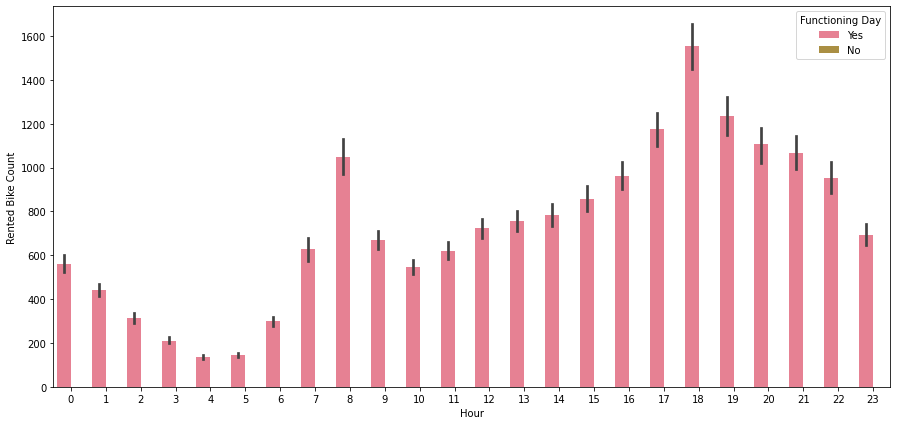

In [9]:
def barplots(x,y,hue):
    plt.figure(figsize=(15,7))
    sns.set_palette("husl")
    sns.barplot(x=x,y=y,hue=hue,data=data);
barplots('Hour','Rented Bike Count','Functioning Day')

In [10]:
# GROUPING BY FUNCTIONING DAY AND CALCULATING THE TOTAL RENTED BIKE COUNT
data.groupby('Functioning Day').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()

,Functioning Day,Rented Bike Count
0,Yes,6172314
1,No,0


As per diagnosis data found that rental bike only given on Functioning Day,So remove Non Functioning Days and then remove Functioning Day Column Also

In [11]:
#Removing data of non functional days (non rented days)
df=data.drop(data[data['Functioning Day'] == 'No'].index) 

In [12]:
#due to not unsefull in Functioning Day Column ,remove Functioning Day Column
df1=df.drop(['Functioning Day'], axis = 1)

In [13]:
#Checking DataFrame Shape After Removing Non Functional Day Rows And Functional Day Column
print("Filtered Dataframe with only rented bike days :",df1.shape,"\n") 

Filtered Dataframe with only rented bike days : (8465, 13) 





### *2.2 _ Seperate Date, Month, Year from Date Column*

First, let's convert `Date` to a `datecolumn` and extract different parts of the date.

In [14]:
df1['Date'] = pd.to_datetime(df1['Date'])
df1['Date']

0      2017-01-12
1      2017-01-12
2      2017-01-12
3      2017-01-12
4      2017-01-12
          ...    
8755   2018-11-30
8756   2018-11-30
8757   2018-11-30
8758   2018-11-30
8759   2018-11-30
Name: Date, Length: 8465, dtype: datetime64[ns]

In [15]:
#Seperate Day, Month, Year from DataFrame Column

df1['Day']=df1['Date'].dt.day
df1['Month']=df1['Date'].dt.month
df1['Year']=df1['Date'].dt.year

In [16]:
# drop the Date column after extracting necessory information
df1.drop(columns=['Date'],inplace=True)

##**3. Exploratory Analysis and Visualization**

Let's explore the data by visualizing the distribution of values in some columns of the dataset, and the relationships between "Rented Bike count" and other columns.


> We'll use libraries Matplotlib, Seaborn for visualization.




###*3.1 _ Checking Correlation Of Data*

Rented Bike Count             True
Hour                          True
Temperature(°C)               True
Humidity(%)                  False
Wind speed (m/s)             False
Visibility (10m)              True
Dew point temperature(°C)     True
Solar Radiation (MJ/m2)       True
Rainfall(mm)                 False
Snowfall (cm)                False
Day                          False
Month                        False
Year                          True
Name: Rented Bike Count, dtype: bool

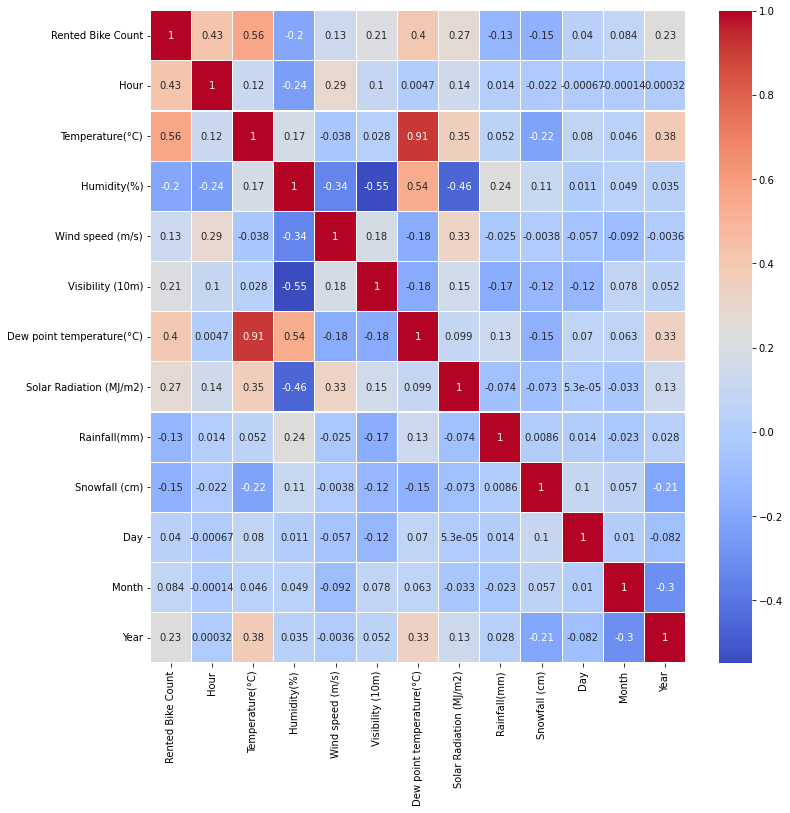

In [17]:
data_corr= df1.corr()
plt.figure(figsize=(12,12))
sns.heatmap(data_corr, cmap='coolwarm', linewidths=0.1, annot=True, linecolor='white')
data_corr['Rented Bike Count' ]>0.2

`temperature` and `Dew point temperature` are almost 0.91 correlated, So it's generate multicollinearity issue. so we drop `Dew point temperature` feature

In [18]:
df1.drop(columns=['Dew point temperature(°C)'],inplace=True)

Finding Insides:

1. We can see that with our targer variable (Rented Bike Count), the most correlated variables are : Hour, Temperature, Dew point temperature

###*3.2 _ Seperate Numerical And Categorical Variables*

#### Numarical Variables

In [19]:
numerical_features=[col for col in df1.columns if df1[col].dtype!='O']
numerical_features

['Rented Bike Count',
 'Hour',
 'Temperature(°C)',
 'Humidity(%)',
 'Wind speed (m/s)',
 'Visibility (10m)',
 'Solar Radiation (MJ/m2)',
 'Rainfall(mm)',
 'Snowfall (cm)',
 'Day',
 'Month',
 'Year']

In [20]:
# Seprate dataframe for Numerical feature
num_data=df1[numerical_features]
num_data

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Day,Month,Year
0,254,0,-5.2,37,2.2,2000,0.0,0.0,0.0,12,1,2017
1,204,1,-5.5,38,0.8,2000,0.0,0.0,0.0,12,1,2017
2,173,2,-6.0,39,1.0,2000,0.0,0.0,0.0,12,1,2017
3,107,3,-6.2,40,0.9,2000,0.0,0.0,0.0,12,1,2017
4,78,4,-6.0,36,2.3,2000,0.0,0.0,0.0,12,1,2017
...,...,...,...,...,...,...,...,...,...,...,...,...
8755,1003,19,4.2,34,2.6,1894,0.0,0.0,0.0,30,11,2018
8756,764,20,3.4,37,2.3,2000,0.0,0.0,0.0,30,11,2018
8757,694,21,2.6,39,0.3,1968,0.0,0.0,0.0,30,11,2018
8758,712,22,2.1,41,1.0,1859,0.0,0.0,0.0,30,11,2018


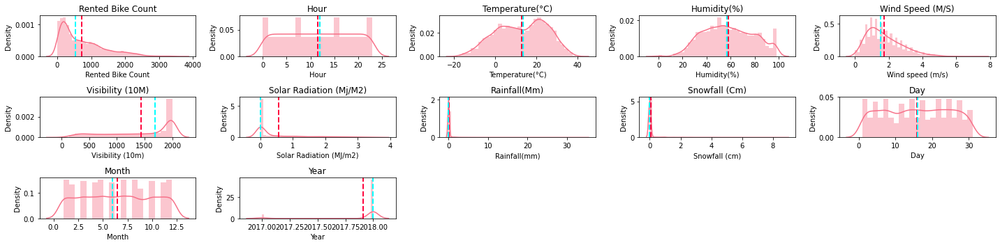

In [21]:
fig = plt.figure(figsize = (20,5))
for index,column in enumerate(numerical_features) :
  plt.subplot(3,5,index+1)
  sns.distplot(df1[column])
  feature = df1[column]
  ax = fig.gca()
  ax.axvline(feature.mean(), color='#ff033e', linestyle='dashed', linewidth=2)
  ax.axvline(feature.median(), color='#00ffff', linestyle='dashed', linewidth=2)
  plt.title(f'{column.title()}')
  plt.tight_layout()

#####Discrete Values

Discrete Variables Count: 4


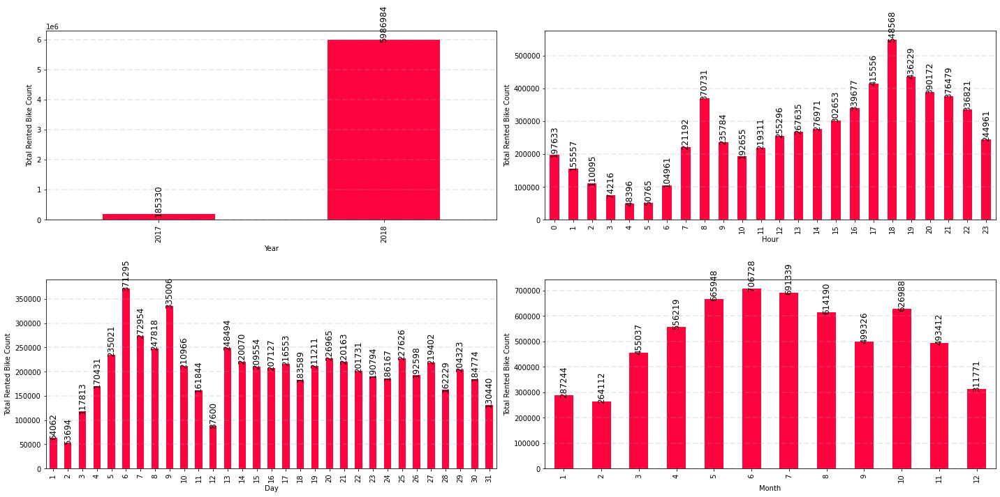

In [22]:
## Lets analyse the discrete values by creating histograms to understand the distribution
num_discrete_value=[feature for feature in numerical_features if len(df1[feature].unique())<32]
print("Discrete Variables Count: {}".format(len(num_discrete_value)))

fig = plt.figure(figsize = (20,10))
for index,column in enumerate(num_discrete_value) :
  plt.subplot(2,2,index+1)
  dataset=df1.copy()
  dataset.groupby(feature)['Rented Bike Count'].sum().plot(kind='bar',color="#ff033e")
  feature = df1[column]
  ax = fig.gca()
  plt.ylabel('Total Rented Bike Count')
  plt.tight_layout()
  plt.grid(color='#95a5a6', linestyle='--', linewidth=2, axis='y', alpha=0.2)
  for p in ax.patches:
      ax.annotate(round(p.get_height()),(p.get_x() + p.get_width()/2,p.get_height()),ha='center',size= 12, rotation=90)

#### Categorical Variables

In [23]:
#For categorical Data
categorical_features=[col for col in df1.columns if df1[col].dtype=='O']
categorical_features

['Seasons', 'Holiday']

In [24]:
# Seprate dataframe for Categorical feature
cat_data=df1[categorical_features]

In [25]:
# Unique number of categorical features
for feature in categorical_features:
    print('The feature is {} and number of categories are {}'.format(feature,len(data[feature].unique())))

The feature is Seasons and number of categories are 4
The feature is Holiday and number of categories are 2


In [26]:
# GROUPING BY SEASONS AND CALCULATING THE TOTAL RENTED BIKE COUNT
data.groupby('Seasons').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()

,Seasons,Rented Bike Count
0,Summer,2283234
1,Autumn,1790002
2,Spring,1611909
3,Winter,487169


In [27]:
# GROUPING BY HOLIDAY AND CALCULATING THE TOTAL RENTED BIKE COUNT
data.groupby('Holiday').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()

,Holiday,Rented Bike Count
0,No Holiday,5956419
1,Holiday,215895


##### Categorical Values

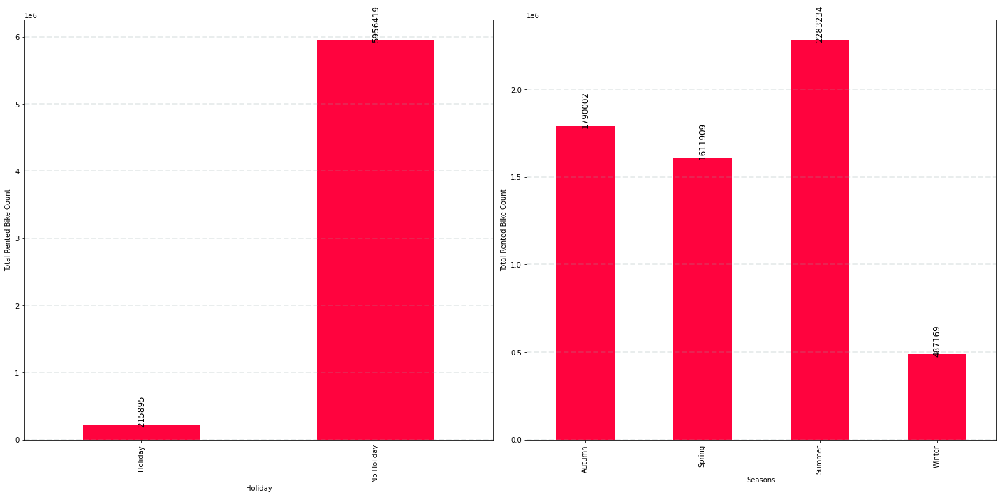

In [28]:
#Find out the relationship between categorical variable and dependent feature Rented Bike Count

fig = plt.figure(figsize = (20,10))
for index,column in enumerate(categorical_features) :
    plt.subplot(1,2,index+1)
    dataset=df1.copy()
    dataset.groupby(feature)['Rented Bike Count'].sum().plot(kind='bar',color="#ff033e")
    feature = df1[column]
    ax = fig.gca()
    plt.ylabel('Total Rented Bike Count')
    plt.tight_layout()
    plt.grid(color='#95a5a6', linestyle='--', linewidth=2, axis='y', alpha=0.2)
    for p in ax.patches:
        ax.annotate(round(p.get_height()),(p.get_x() + p.get_width()/2,p.get_height()),ha='center',size= 12, rotation=90)


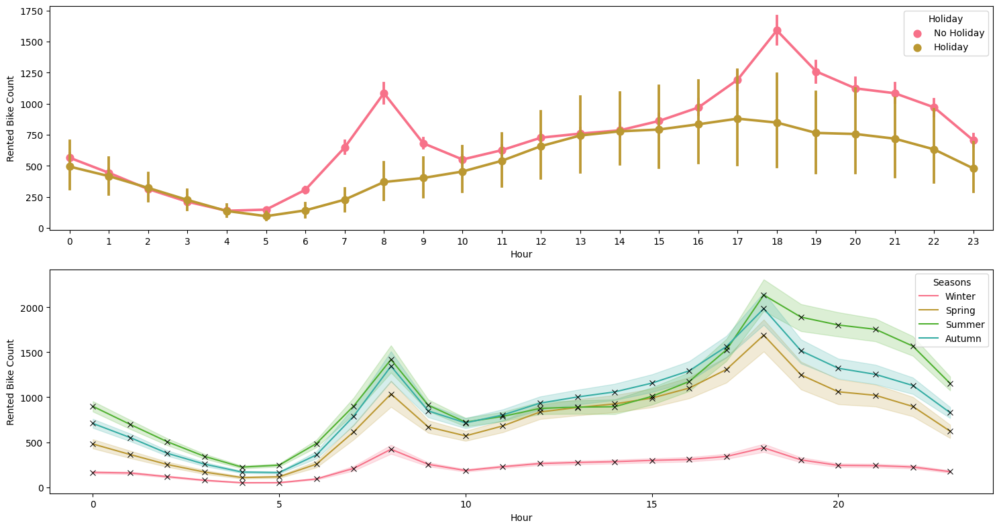

In [29]:
fig, axs = plt.subplots(nrows=2,ncols=1,figsize=(15,8), dpi=100)
sns.pointplot(data=dataset, x="Hour", y="Rented Bike Count", ax=axs[0], 
              hue="Holiday")
sns.lineplot(data=dataset, x="Hour", y="Rented Bike Count", ax=axs[1], 
              hue="Seasons", marker="x",markeredgecolor="black")
plt.tight_layout()

## **4. Feature Engineering On Data**


1. [Encode](https://scikit-learn.org/stable/modules/preprocessing.html#encoding-categorical-features) categorical data into one-hot vectors.
2. Identify Inputs and Target
3. [Scale](https://scikit-learn.org/stable/modules/preprocessing.html#scaling-features-to-a-range) values in numeric columns to a $(0,1)$ range.
4. Split the dataset into training and validation sets.


### *4.1 _ Encoding Data*

Encode categorical data in both encoder and check accuracy of encoders:
1. oh_df : OneHotEncoder Data 
2. le_df : LabelEncoder Data 

####4.1.1 _ Apply OneHotEncoder on Data



Since machine learning models can only be trained with numeric data, we need to convert categorical data to numbers. A common technique is to use one-hot encoding for categorical columns.

<img src="https://i.imgur.com/n8GuiOO.png" width="640">

One hot encoding involves adding a new binary (0/1) column for each unique category of a categorical column.

In [30]:
#oh_df=pd.get_dummies(df1, columns=['Seasons', 'Holiday'], drop_first=True)
#oh_df

One-hot encoding approach eliminates the order but it causes the number of columns to expand vastly. So for columns with more unique values try using other techniques like LabelEncoding

#### 4.1.2 _ Apply LabelEncoder

In [31]:
# Encode labels of multiple columns at ones using LabelEncoder
le_df= df1.apply(LabelEncoder().fit_transform)
le_df

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Day,Month,Year
0,252,0,111,28,22,1779,0,0,0,3,1,11,0,0
1,202,1,108,29,8,1779,0,0,0,3,1,11,0,0
2,171,2,103,30,10,1779,0,0,0,3,1,11,0,0
3,105,3,101,31,9,1779,0,0,0,3,1,11,0,0
4,76,4,103,27,23,1779,0,0,0,3,1,11,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,990,19,205,25,26,1673,0,0,0,0,1,29,10,1
8756,754,20,197,28,23,1779,0,0,0,0,1,29,10,1
8757,685,21,189,30,3,1747,0,0,0,0,1,29,10,1
8758,703,22,184,32,10,1639,0,0,0,0,1,29,10,1


Checking Season Column Data

In [32]:
df1.groupby("Seasons").count()

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Holiday,Day,Month,Year
Seasons,,,,,,,,,,,,,
Autumn,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937
Spring,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160
Summer,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208
Winter,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160


In [33]:
le_df.groupby('Seasons').count()

,Rented Bike Count,Hour,Temperature(°C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Holiday,Day,Month,Year
Seasons,,,,,,,,,,,,,
0,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937
1,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160
2,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208
3,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160


0 : Autumn , 1 : Spring , 2 : Summer , 3 : Winter

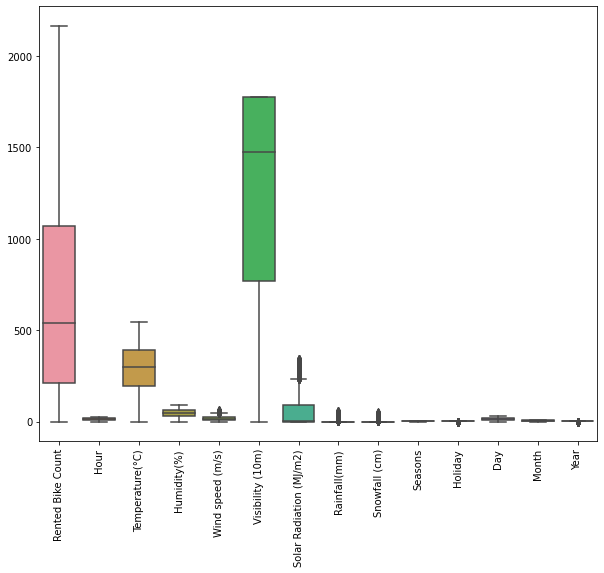

In [34]:
#checking for outliers
plt.figure(figsize=(10,8))
plt.xticks(rotation =90)
sns.boxplot(data = le_df)
plt.show()

Target Parameter `Rented Bike Count` distributation analysis

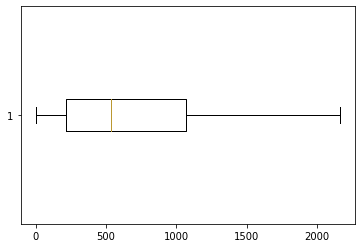

In [35]:
plt.boxplot(le_df['Rented Bike Count'],vert=False)
plt.show()

above plot indicate that the data is positive screw

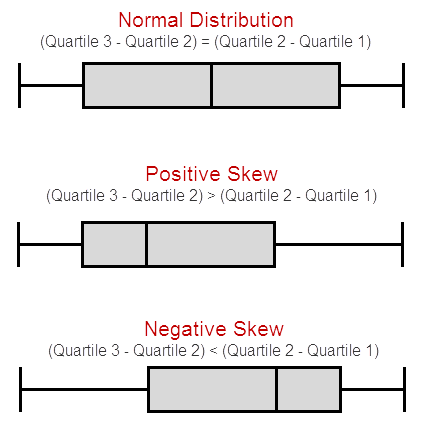

Outline detection using Interquartile Range

In [36]:
import scipy.stats as stats

In [37]:
def plotvariable(df,variable):
  plt.figure(figsize=(12,8))
  plt.subplot(1,2,1)   #means 1 row, 2 Columns and 1st plot
  df[variable].hist(bins=30)

  ##QQ plot
  plt.subplot(1,2,2)
  stats.probplot(df[variable], dist='norm',plot=plt)
  plt.show()


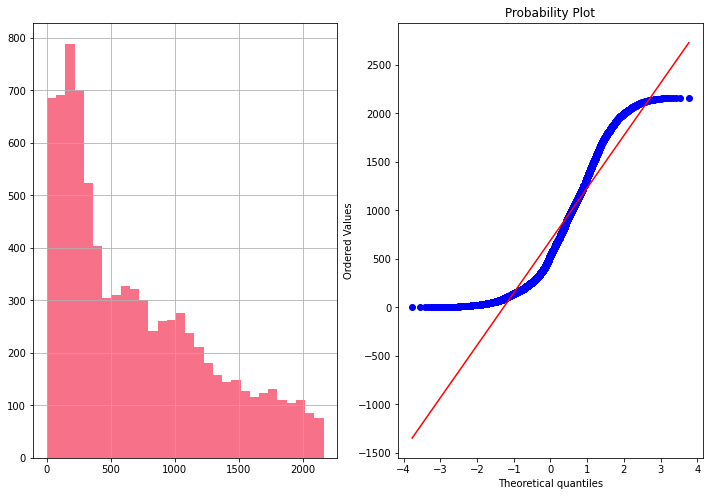

In [38]:
plotvariable(le_df,'Rented Bike Count')

our `Rented Bike Count` target is not normally distributed ,so we need to make some transformations before supply to the model

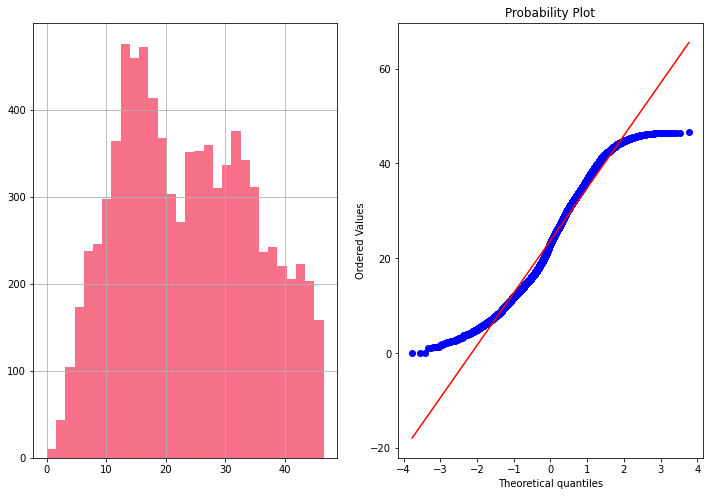

In [39]:
le_df['Rented Bike Count']=np.sqrt(le_df['Rented Bike Count'])

plotvariable(le_df,'Rented Bike Count')

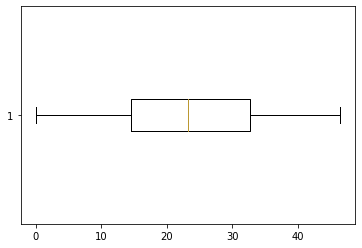

In [40]:
plt.boxplot(le_df["Rented Bike Count"],vert=False)
plt.show()

Now, Its Look Like Normal Distributation

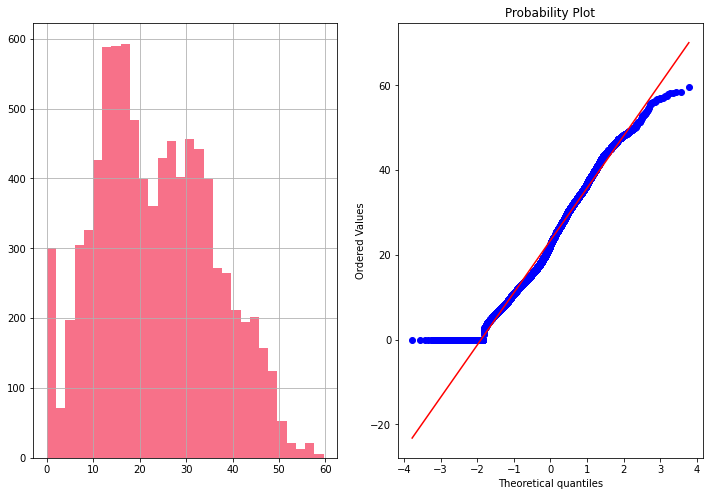

In [41]:
data["RBC_sqrt"]=(data['Rented Bike Count']) ** (1/2) #try another technique to convert positive screwd to normal distributation

plotvariable(data,"RBC_sqrt")

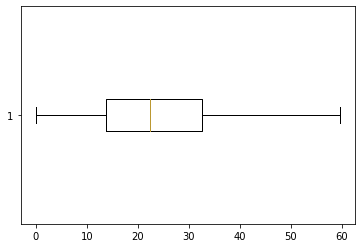

In [42]:
plt.boxplot(data["RBC_sqrt"],vert=False)
plt.show()

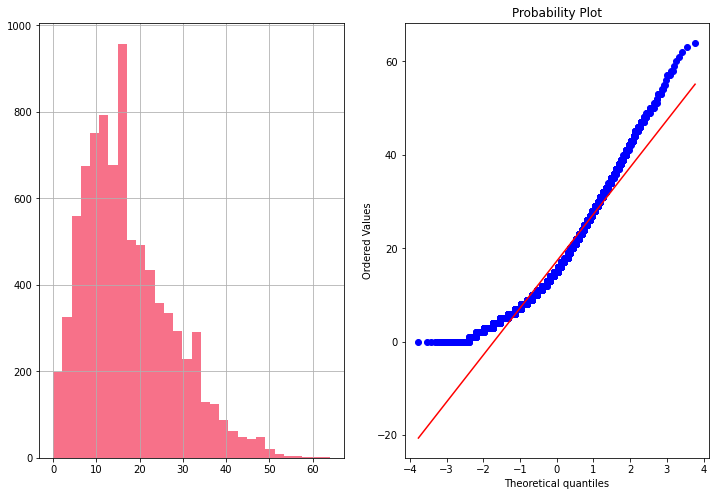

In [43]:
plotvariable(le_df,'Wind speed (m/s)')

not look like normal and right screwed distributation so need to apply transformation

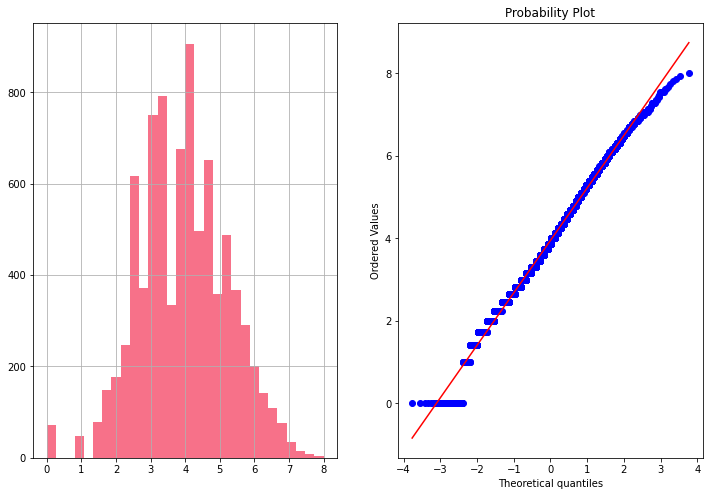

In [44]:
le_df['Wind speed (m/s)']=np.sqrt(le_df['Wind speed (m/s)'])

plotvariable(le_df,'Wind speed (m/s)')

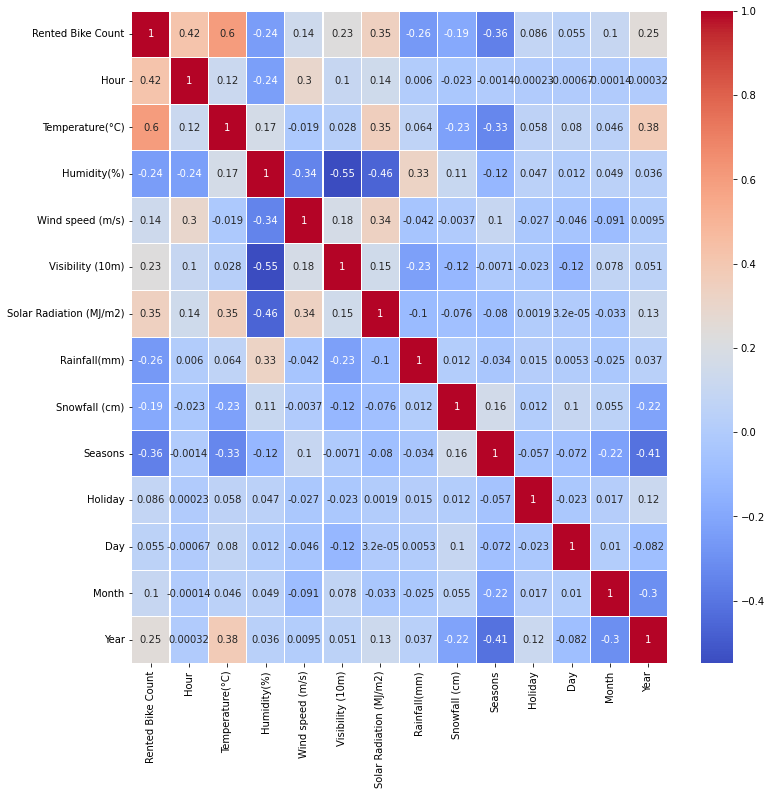

In [45]:
data_corr= le_df.corr()
plt.figure(figsize=(12,12))
sns.heatmap(data_corr, cmap='coolwarm', linewidths=0.1, annot=True, linecolor='white')

In [46]:
le_df.columns

Index(['Rented Bike Count', 'Hour', 'Temperature(°C)', 'Humidity(%)',
       'Wind speed (m/s)', 'Visibility (10m)', 'Solar Radiation (MJ/m2)',
       'Rainfall(mm)', 'Snowfall (cm)', 'Seasons', 'Holiday', 'Day', 'Month',
       'Year'],
      dtype='object')

### *4.2 _ Identify Inputs and Targets*

- The column `Rented Bike Count` contains the value we need to predict i.e. it's the target column.
- Data from all the other columns (except the first and the last column) can be used as inputs to the model.
 

>Create a list `X` of column names containing data that can be used as input to train the model, and identify the target column as the variable `y`.

>Make sure that the `Date` and `Rented Bike Count` columns are not included in `X`.

Now that we've identified the input and target columns, we can separate input & target data.

In [47]:
# Identify the input columns (a list of column names)

X=le_df.drop('Rented Bike Count',axis=1)
y=le_df['Rented Bike Count']

### *4.3 _ Spliting Training and Testing Set*
Finally, let's split the dataset into a training and testing set. We'll use a randomly select 30% subset of the data for validation. Also, we'll use just the numeric and encoded columns.

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [49]:
# Let's check the shape of the train and test dataset

print(f'The shape of the train and test set for the independent variables are : X_train = {X_train.shape}, X_test = {X_test.shape}')
print(f'The shape of the train and test set for the dependent variables are : y_train = {y_train.shape}, y_test = {y_test.shape}')

The shape of the train and test set for the independent variables are : X_train = (6772, 13), X_test = (1693, 13)
The shape of the train and test set for the dependent variables are : y_train = (6772,), y_test = (1693,)


## **Scaling Data and Model Building**

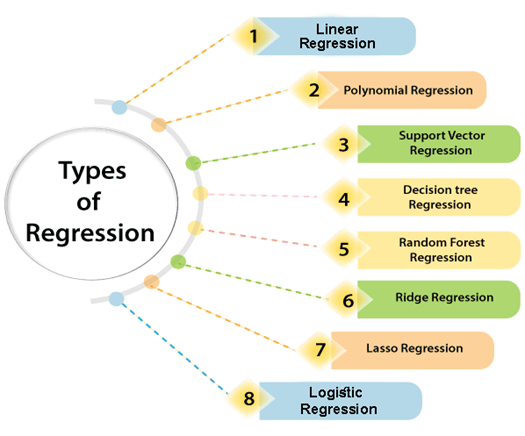

In [50]:
def predict(ml_model,X,y):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.20,random_state=10)
    rob =RobustScaler()

    X_train = rob.fit_transform(X_train)
    X_test = rob.transform(X_test)

    model=ml_model.fit(X_train,y_train)
    y_pred=model.predict(X_test)
    plt.scatter(y_pred,y_test,color='b')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    print(f'R^2 is {model.score(X_test,y_test)}\n Adj R^2 is {1-(1-model.score(X_test,y_test))*(len(y_test)-1)/(len(y_test)-X_test.shape[1]-1)}\n RMSE is: {mean_squared_error(y_test,y_pred,squared=False)}')
    

In [ ]:
plt.plot(np.arange(len(y_pred)) + len(y_train),y_test)
plt.plot(np.arange(len(y_pred)) + len(y_train), y_pred)
plt.plot(y_train)
plt.plot(train)

# you seemed to mess up the labels
plt.legend(['y_test', 'y_test_pred', 'y_train','y_train_pred'])

R^2 is 0.6484023843668458
 Adj R^2 is 0.645680068105243
 RMSE is: 6.782028398532071


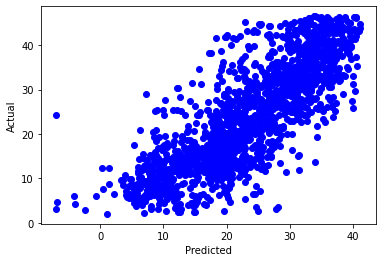

In [51]:
predict(LinearRegression(),X,y)

R^2 is 0.7905713586615266
 Adj R^2 is 0.7889498146845164
 RMSE is: 5.234252642752789


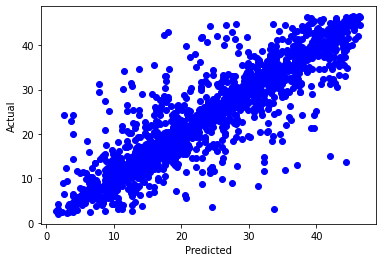

In [52]:
predict(DecisionTreeRegressor(),X,y)

R^2 is 0.901361506971813
 Adj R^2 is 0.9005977783182297
 RMSE is: 3.592194616459418


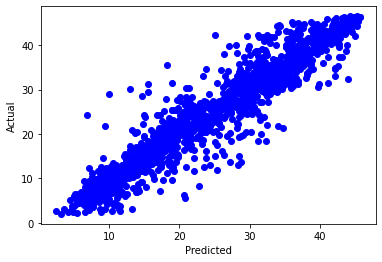

In [53]:
predict(RandomForestRegressor(),X,y)

R^2 is 0.9092926042308541
 Adj R^2 is 0.9085902837156672
 RMSE is: 3.444752250753312


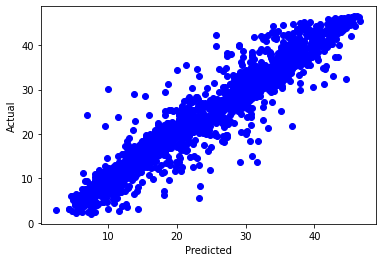

In [54]:
predict(LGBMRegressor(),X,y)

In [55]:
def predict_mm(ml_model,X,y):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.20,random_state=10)
    mm =MinMaxScaler()

    X_train = mm.fit_transform(X_train)
    X_test = mm.transform(X_test)

    model=ml_model.fit(X_train,y_train)
    y_pred=model.predict(X_test)
    plt.scatter(y_pred,y_test,color='g')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    print(f'R^2 is {model.score(X_test,y_test)}\n Adj R^2 is {1-(1-model.score(X_test,y_test))*(len(y_test)-1)/(len(y_test)-X_test.shape[1]-1)}\n RMSE is: {mean_squared_error(y_test,y_pred,squared=False)}')
    

R^2 is 0.6484023843668462
 Adj R^2 is 0.6456800681052435
 RMSE is: 6.782028398532068


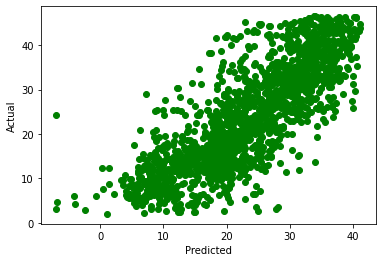

In [56]:
predict_mm(LinearRegression(),X,y)

R^2 is 0.7986852070828203
 Adj R^2 is 0.7971264862323597
 RMSE is: 5.131856308871574


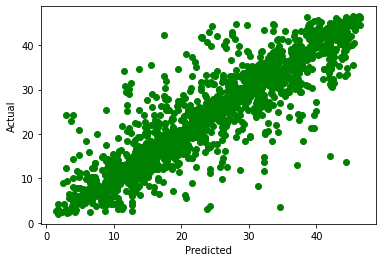

In [57]:
predict_mm(DecisionTreeRegressor(),X,y)

R^2 is 0.9008787558792722
 Adj R^2 is 0.9001112894268783
 RMSE is: 3.6009742481261777


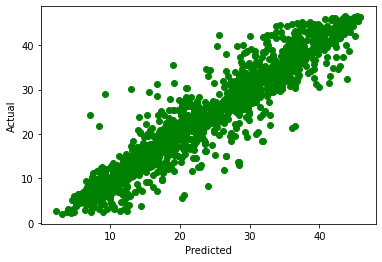

In [58]:
predict_mm(RandomForestRegressor(),X,y)

R^2 is 0.9086899452289576
 Adj R^2 is 0.9079829585035117
 RMSE is: 3.4561767553073417


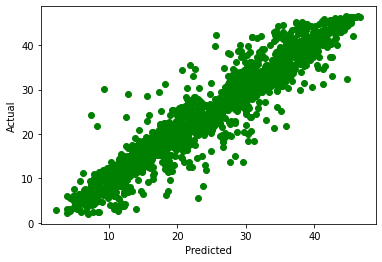

In [59]:
predict_mm(LGBMRegressor(),X,y)

In [60]:
def predict_ss(ml_model,X,y):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.20,random_state=10)
    ss =StandardScaler()

    X_train = ss.fit_transform(X_train)
    X_test = ss.transform(X_test)

    model=ml_model.fit(X_train,y_train)
    y_pred=model.predict(X_test)
    plt.scatter(y_pred,y_test,color='r')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    print(f'R^2 is {model.score(X_test,y_test)} \n Adj R^2 is {1-(1-model.score(X_test,y_test))*(len(y_test)-1)/(len(y_test)-X_test.shape[1]-1)}\n RMSE is: {mean_squared_error(y_test,y_pred,squared=False)}')
    pred_y_df=pd.DataFrame({"Actual Value":y_test,"Predicted Value":y_pred,"Difference":y_test-y_pred})
    print(pred_y_df[0:10])

R^2 is 0.6484023843668462 
 Adj R^2 is 0.6456800681052435
 RMSE is: 6.782028398532068
      Actual Value  Predicted Value  Difference
5028     33.749074        29.317478    4.431596
5121     11.224972         9.318051    1.906921
4191     33.955854        34.200968   -0.245115
8498     16.852300        19.913517   -3.061218
8072     41.713307        19.744203   21.969104
3300     33.075671        30.792839    2.282832
1461      7.615773         5.867516    1.748257
1324      4.472136         5.409999   -0.937863
8128     39.862263        36.828032    3.034231
16       21.931712        18.670651    3.261061


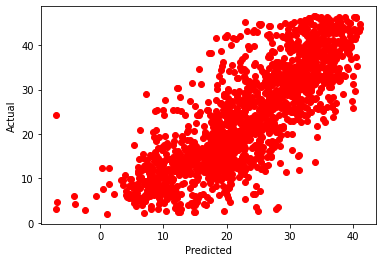

In [61]:
predict_ss(LinearRegression(),X,y)

R^2 is 0.8005813882663173 
 Adj R^2 is 0.7990373489854729
 RMSE is: 5.107630687764368
      Actual Value  Predicted Value  Difference
5028     33.749074        32.741411    1.007663
5121     11.224972         5.000000    6.224972
4191     33.955854        35.411862   -1.456009
8498     16.852300        18.248288   -1.395988
8072     41.713307        22.934690   18.778617
3300     33.075671        30.099834    2.975837
1461      7.615773         6.082763    1.533011
1324      4.472136         5.656854   -1.184718
8128     39.862263        34.423829    5.438434
16       21.931712        22.248595   -0.316883


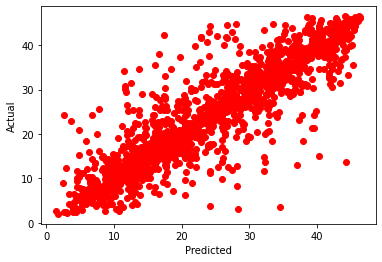

In [62]:
predict_ss(DecisionTreeRegressor(),X,y)

R^2 is 0.9012702741302002 
 Adj R^2 is 0.9005058390877301
 RMSE is: 3.593855481134231
      Actual Value  Predicted Value  Difference
5028     33.749074        32.186929    1.562145
5121     11.224972         7.037270    4.187703
4191     33.955854        36.481535   -2.525681
8498     16.852300        16.738784    0.113516
8072     41.713307        33.923729    7.789579
3300     33.075671        32.374781    0.700890
1461      7.615773         8.638287   -1.022514
1324      4.472136         5.634788   -1.162652
8128     39.862263        36.627718    3.234545
16       21.931712        20.674006    1.257706


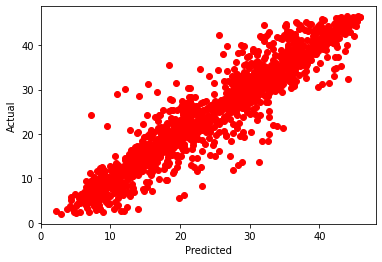

In [63]:
predict_ss(RandomForestRegressor(),X,y)

R^2 is 0.9070138170111401 
 Adj R^2 is 0.9062938525210537
 RMSE is: 3.487754065892132
      Actual Value  Predicted Value  Difference
5028     33.749074        31.984073    1.765001
5121     11.224972         7.738305    3.486668
4191     33.955854        38.245208   -4.289355
8498     16.852300        16.871841   -0.019541
8072     41.713307        32.376403    9.336904
3300     33.075671        31.743416    1.332255
1461      7.615773         6.103525    1.512248
1324      4.472136         5.273349   -0.801213
8128     39.862263        37.596787    2.265476
16       21.931712        17.638108    4.293604


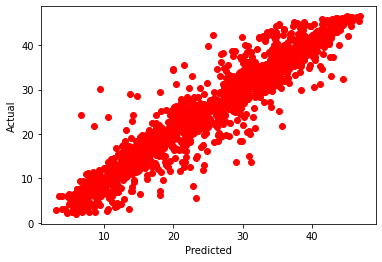

In [64]:
predict_ss(LGBMRegressor(),X,y)

In [65]:
import lightgbm
import time
from math import sqrt
from sklearn import preprocessing, model_selection, metrics
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error

In [66]:
models = [
           ['LinearRegression: ',              LinearRegression()],
           ['Lasso: ',                         Lasso()],
           ['Ridge: ',                         Ridge()],
           ['KNeighborsRegressor: ',           neighbors.KNeighborsRegressor()],
           ['SVR:' ,                           SVR(kernel='rbf')],
           ['DecisionTree ',                   DecisionTreeRegressor(random_state=42)],
           ['RandomForest ',                   RandomForestRegressor(random_state=42)],
           ['ExtraTreeRegressor :',            ExtraTreesRegressor(random_state=42)],
           ['GradientBoostingRegressor: ',     GradientBoostingRegressor(random_state=42)],
           ['XGBRegressor: ',                  xgb.XGBRegressor(random_state=42)] ,
           ['Light-GBM: ',                     lightgbm.LGBMRegressor(num_leaves=41, n_estimators=200,random_state=42)],
           ['MLPRegressor: ', MLPRegressor(  activation='logistic', solver='sgd',learning_rate='adaptive',max_iter=1000,learning_rate_init=0.01,alpha=0.01)]
]

In [67]:
model_data = []
for name,curr_model in models :
    curr_model_data = {}
    curr_model.random_state = 78
    curr_model_data["Name"] = name
    start = time.time()
    curr_model.fit(X_train,y_train)
    end = time.time()
    curr_model_data["Train_Time"] = end - start
    curr_model_data["Train_R2_Score"] = metrics.r2_score(y_train,curr_model.predict(X_train))
    curr_model_data["Test_R2_Score"] = metrics.r2_score(y_test,curr_model.predict(X_test))
    curr_model_data["Test_RMSE_Score"] = sqrt(mean_squared_error(y_test,curr_model.predict(X_test)))
    model_data.append(curr_model_data)

[14:47:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [68]:
model_data

[{'Name': 'LinearRegression: ',
  'Train_Time': 0.007924318313598633,
  'Train_R2_Score': 0.6478907877040745,
  'Test_R2_Score': 0.6583635068923448,
  'Test_RMSE_Score': 6.4352389952296525},
 {'Name': 'Lasso: ',
  'Train_Time': 0.006690025329589844,
  'Train_R2_Score': 0.6362247150339719,
  'Test_R2_Score': 0.6434832997542703,
  'Test_RMSE_Score': 6.573890897623658},
 {'Name': 'Ridge: ',
  'Train_Time': 0.005267143249511719,
  'Train_R2_Score': 0.6478907426327043,
  'Test_R2_Score': 0.6583560977217399,
  'Test_RMSE_Score': 6.435308776306985},
 {'Name': 'KNeighborsRegressor: ',
  'Train_Time': 0.017859458923339844,
  'Train_R2_Score': 0.7595401403043068,
  'Test_R2_Score': 0.634924859314125,
  'Test_RMSE_Score': 6.65232844723656},
 {'Name': 'SVR:',
  'Train_Time': 3.338355302810669,
  'Train_R2_Score': 0.45718840668401606,
  'Test_R2_Score': 0.4651504542193533,
  'Test_RMSE_Score': 8.051899927587922},
 {'Name': 'DecisionTree ',
  'Train_Time': 0.05485248565673828,
  'Train_R2_Score': 1.

## Models

In [69]:
df_all_model=pd.DataFrame(model_data)
df_all_model

,Name,Train_Time,Train_R2_Score,Test_R2_Score,Test_RMSE_Score
0,LinearRegression:,0.007924,0.647891,0.658364,6.435239
1,Lasso:,0.006690,0.636225,0.643483,6.573891
2,Ridge:,0.005267,0.647891,0.658356,6.435309
3,KNeighborsRegressor:,0.017859,0.759540,0.634925,6.652328
4,SVR:,3.338355,0.457188,0.465150,8.051900
5,DecisionTree,0.054852,1.000000,0.796217,4.970115
6,RandomForest,3.392389,0.985689,0.888823,3.671046
7,ExtraTreeRegressor :,2.005425,1.000000,0.895523,3.558714
8,GradientBoostingRegressor:,0.998386,0.888886,0.872145,3.936779
9,XGBRegressor:,0.406234,0.886665,0.870448,3.962830


As per above results Train and Test R2 Score is nearby in good model.

Near 1 Score is very good model.

So, In above results best models are : 

|No|Model Name| Model Accuracy Score in % |
|--|----------|------------|
|6|	RandomForest|	88%|
|7|	ExtraTreeRegressor| 89%|
|8|	GradientBoostingRegressor|87%|
|9|	XGBRegressor|87%|
|10|	Light-GBM|90%|

# HyperParameter tuning 
Apply on GradientBoostingRegressor Model and improve Accuracy of Model.

 Choose the best Hyperparameters

It’s a bit confusing to choose the best hyperparameters for boosting. But once you know how the boosting algorithms work, then you are able to choose it. Here are the best ones that I have chosen, learning_rate, max_depth, and the n_estimators. The max_depth and n_estimators are also the same parameters we chose in a random forest. Here we are taking an extra that is the learning_rate.

Call the Boosting regressor constructor and define the parameters.
Here you will make the list of all possibilities for each of the Hyperparameters.

In [71]:
gbr = GradientBoostingRegressor()
gbr_params = {
    "n_estimators":[250,500,1000],
    "max_depth":[2,4,6],
    "learning_rate":[0.01,0.1,1],
    "loss": ['ls','huber','quantile'],
}

In [72]:
regressor = GridSearchCV(gbr, gbr_params, verbose=1,cv=3,n_jobs=-1) 
regressor.fit(X_train,y_train) 

#it's take around 26min _ take a tea break

Fitting 3 folds for each of 81 candidates, totalling 243 fits


GridSearchCV(cv=3, estimator=GradientBoostingRegressor(), n_jobs=-1,
             param_grid={'learning_rate': [0.01, 0.1, 1],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_depth': [2, 4, 6],
                         'n_estimators': [250, 500, 1000]},
             verbose=1)

In [73]:
regressor.best_params_

{'learning_rate': 0.1, 'loss': 'huber', 'max_depth': 6, 'n_estimators': 1000}

In [74]:
regressor.best_estimator_ 

GradientBoostingRegressor(loss='huber', max_depth=6, n_estimators=1000)

In [78]:
predictions = regressor.predict(X_test) 

In [79]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

print('Root Mean Squared Error is {} '.format(np.sqrt(mean_squared_error(y_test,
                                                    regressor.predict(X_test)))) )
 

Root Mean Squared Error is 3.2185400582427137 


**Now apply best selected paramter and checking result**

In [81]:
X=le_df.drop('Rented Bike Count',axis=1)
y=le_df['Rented Bike Count']

X_train, X_test, y_train, y_test = train_test_split(X,y, random_state=42, test_size=0.1)
#
# Standardize the dataset
#
sc = StandardScaler()
X_train_std = sc.fit_transform(X_train)
X_test_std = sc.transform(X_test)
#
# Hyperparameters for GradientBoostingRegressor
#
gbr_params = {'n_estimators': 1000,
          'max_depth': 6,
          'min_samples_split': 10,
          'learning_rate': 0.1,
          'loss': 'huber'}
#
# Create an instance of gradient boosting regressor
#
gbr = GradientBoostingRegressor(**gbr_params)
#
# Fit the model
#
gbr.fit(X_train_std, y_train)
#
# Print Coefficient of determination R^2
#
print("Model Accuracy: %.3f" % gbr.score(X_test_std, y_test))
#
# Create the mean squared error
#
mse = mean_squared_error(y_test, gbr.predict(X_test_std))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
print('Root Mean Squared Error is {} '.format(np.sqrt(mean_squared_error(y_test,
                                                    regressor.predict(X_test)))) )
 

Model Accuracy: 0.916
The mean squared error (MSE) on test set: 9.9938
Root Mean Squared Error is 3.2185400582427137 


+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

Using Hyperperameters tuning, Improve accurecy of model from 87% to **91%**
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++